In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import re
import geopandas as gpd
import folium
import plotly.express as px
import matplotlib.colors as mcolors

In [2]:
def convert_google_sheet_url(url):
    # Regular expression to match and capture the necessary part of the URL
    pattern = r'https://docs\.google\.com/spreadsheets/d/([a-zA-Z0-9-_]+)(/edit#gid=(\d+)|/edit.*)?'
    # Replace function to construct the new URL for CSV export
    # If gid is present in the URL, it includes it in the export URL, otherwise, it's omitted
    replacement = lambda m: f'https://docs.google.com/spreadsheets/d/{m.group(1)}/export?' + (f'gid={m.group(3)}&' if m.group(3) else '') + 'format=csv'
    # Replace using regex
    new_url = re.sub(pattern, replacement, url)
    return new_url

In [63]:
# Replace with your modified URL
plant22_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1VYqTMIXBYOw6Ydv4bxr377RQfrn04_Cd/edit#gid=2038875755')
wind22_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1_egOKaLODRe2Ps0je4_qgt2ygDIi9nTP/edit#gid=1039656015')
solar22_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1Qqmwc20dxt8gpDHd2HIDehmZ5evTMruQ/edit#gid=956595394')
gen22_op_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/10z3H5-LFRZzKEH6H9T7KUPgHotRI1Eyw/edit#gid=1173785771')
gen22_prop_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/10z3H5-LFRZzKEH6H9T7KUPgHotRI1Eyw/edit#gid=435449641')
gen22_rc_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/10z3H5-LFRZzKEH6H9T7KUPgHotRI1Eyw/edit#gid=403149097')

plant21_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1jEfVlqDV8R3vnxfyEEUYTO7cfgflXKI9/edit#gid=644465266')
wind21_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1J9WjDtMIXtqLycMmTUs2H04VxY90VV-K/edit#gid=580307946')
solar21_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1mCl9woHqa2I7U8xW3BJHiBlH4sDQU-FC/edit#gid=321742167')
gen21_op_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1BboZWpp4ytskMPpn0NzCOz3Ck4Rr450S/edit#gid=1598959121')
gen21_prop_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1BboZWpp4ytskMPpn0NzCOz3Ck4Rr450S/edit#gid=752160609')
gen21_rc_url = convert_google_sheet_url('https://docs.google.com/spreadsheets/d/1BboZWpp4ytskMPpn0NzCOz3Ck4Rr450S/edit#gid=1344906815')

In [64]:
plant22_df = pd.read_csv(plant22_url)[1:]
#print('Plant: ', plant22_df.head(5))
wind22_df = pd.read_csv(wind22_url)[1:]
#print('Wind: ', wind22_df.head(5))
solar22_df = pd.read_csv(solar22_url)[1:]
#print('Solar: ', solar22_df.head(5))
gen22_op_df = pd.read_csv(gen22_op_url)[1:]
gen22_prop_df = pd.read_csv(gen22_prop_url)[1:]
gen22_rc_df = pd.read_csv(gen22_rc_url)[1:]
#print('Generators: ', gen22_rc_df.head(5))

plant21_df = pd.read_csv(plant21_url)
wind21_df = pd.read_csv(wind21_url)
solar21_df = pd.read_csv(solar21_url)
gen21_op_df = pd.read_csv(gen21_op_url)
gen21_prop_df = pd.read_csv(gen21_prop_url)
gen21_rc_df = pd.read_csv(gen21_rc_url)

C:\Users\q\AppData\Local\Temp\ipykernel_7560\2124868369.py:7: DtypeWarning: Columns (0,2,15,17,18,25,26,31,35,36,37,38,40,41,42,51,52,53,62,63) have mixed types. Specify dtype option on import or set low_memory=False.
  gen22_op_df = pd.read_csv(gen22_op_url)[1:]
C:\Users\q\AppData\Local\Temp\ipykernel_7560\2124868369.py:15: DtypeWarning: Columns (0,2,9,13,14,15,17,18,25,26,31,34,35,36,37,38,39,40,41,42,47,48,49,50,51,52,53,62,63) have mixed types. Specify dtype option on import or set low_memory=False.
  gen21_op_df = pd.read_csv(gen21_op_url)


In [53]:
# Set the column names to the values in the first row, remove first row
gen22_op_df.columns = gen22_op_df.iloc[0]
gen22_op_df = gen22_op_df[1:]
gen22_prop_df.columns = gen22_prop_df.iloc[0]
gen22_prop_df = gen22_prop_df[1:]
gen22_rc_df.columns = gen22_rc_df.iloc[0]
gen22_rc_df = gen22_rc_df[1:]
wind22_df.columns = wind22_df.iloc[0]
wind22_df = wind22_df[1:]
plant22_df.columns = plant22_df.iloc[0]
plant22_df = plant22_df[1:]

gen21_op_df.columns = gen21_op_df.iloc[0]
gen21_op_df = gen21_op_df[1:]
gen21_prop_df.columns = gen21_prop_df.iloc[0]
gen21_prop_df = gen21_prop_df[1:]
gen21_rc_df.columns = gen21_rc_df.iloc[0]
gen21_rc_df = gen21_rc_df[1:]
wind21_df.columns = wind21_df.iloc[0]
wind21_df = wind21_df[1:]
plant21_df.columns = plant21_df.iloc[0]
plant21_df = plant21_df[1:]

total_plant_df = pd.concat([plant22_df, plant21_df])


In [37]:
gen22_op_tech_counts = gen22_op_df['Technology'].value_counts()
gen22_prop_tech_counts = gen22_prop_df['Technology'].value_counts()
gen22_rc_tech_counts = gen22_rc_df['Technology'].value_counts()
wind22_df['Turbine Hub Height (Feet)'] = pd.to_numeric(wind22_df['Turbine Hub Height (Feet)'], errors='coerce')
wind22_df = wind22_df.dropna(subset=['Turbine Hub Height (Feet)'])

gen21_op_tech_counts = gen21_op_df['Technology'].value_counts()
gen21_prop_tech_counts = gen21_prop_df['Technology'].value_counts()
gen21_rc_tech_counts = gen21_rc_df['Technology'].value_counts()
wind21_df['Turbine Hub Height (Feet)'] = pd.to_numeric(wind21_df['Turbine Hub Height (Feet)'], errors='coerce')
wind21_df = wind21_df.dropna(subset=['Turbine Hub Height (Feet)'])

total_op_tech_counts = gen22_op_tech_counts + gen21_op_tech_counts
total_prop_tech_counts = gen22_prop_tech_counts + gen21_prop_tech_counts
total_rc_tech_counts = gen22_rc_tech_counts + gen21_rc_tech_counts
total_wind_df = wind22_df + wind21_df

In [38]:
# Define a function to categorize technology types
def categorize_technology(tech_type):
    if type(tech_type) == str:
        if 'natural gas' in tech_type.lower():
            return 'Natural Gas'
        elif 'solar' in tech_type.lower():
            return 'Solar'
        elif 'hydroelectric' in tech_type.lower():
            return 'Hydroelectric'
        elif 'wind' in tech_type.lower():
            return 'Wind'
        elif 'biomass' in tech_type.lower():
            return 'Biomass'
        elif 'coal' in tech_type.lower():
            return 'Coal'
        elif 'petroleum' in tech_type.lower():
            return 'Petroleum'
        elif 'batteries' in tech_type.lower():
            return 'Batteries'
        elif 'gas' in tech_type.lower():
            return 'Other Gasses'
        elif 'nuclear' in tech_type.lower():
            return 'Nuclear'
        else:
            return 'Other'

# Apply the categorization function to the 'Technology' column
gen22_op_df['Technology Group'] = gen22_op_df['Technology'].apply(categorize_technology)
gen22_op_group_counts = gen22_op_df['Technology Group'].value_counts()
gen22_prop_df['Technology Group'] = gen22_prop_df['Technology'].apply(categorize_technology)
gen22_prop_group_counts = gen22_prop_df['Technology Group'].value_counts()
gen22_rc_df['Technology Group'] = gen22_rc_df['Technology'].apply(categorize_technology)
gen22_rc_group_counts = gen22_rc_df['Technology Group'].value_counts()

gen21_op_df['Technology Group'] = gen21_op_df['Technology'].apply(categorize_technology)
gen21_op_group_counts = gen21_op_df['Technology Group'].value_counts()
gen21_prop_df['Technology Group'] = gen21_prop_df['Technology'].apply(categorize_technology)
gen21_prop_group_counts = gen21_prop_df['Technology Group'].value_counts()
gen21_rc_df['Technology Group'] = gen21_rc_df['Technology'].apply(categorize_technology)
gen21_rc_group_counts = gen21_rc_df['Technology Group'].value_counts()

# Assuming gen22_op_tech_counts and gen21_op_tech_counts are already calculated
total_op_group_counts = gen22_op_group_counts + gen21_op_group_counts
total_prop_group_counts = gen22_prop_group_counts + gen21_prop_group_counts
total_rc_group_counts = gen22_rc_group_counts + gen21_rc_group_counts

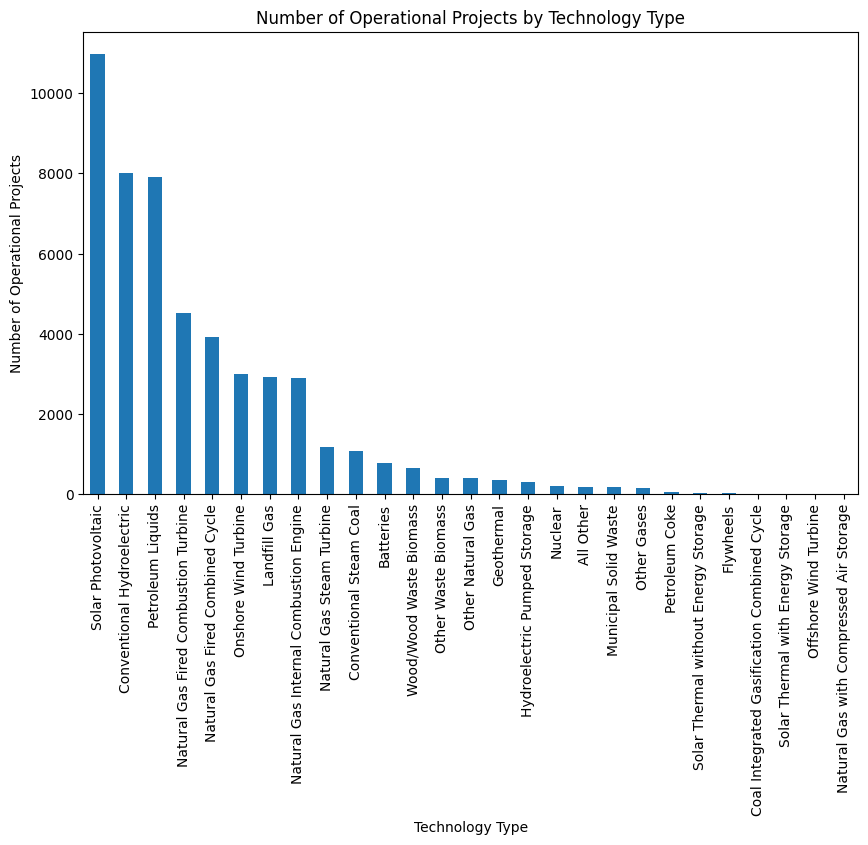

In [39]:
plt.figure(figsize=(10,6))
total_op_tech_counts.sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Technology Type')
plt.ylabel('Number of Operational Projects')
plt.title('Number of Operational Projects by Technology Type')
plt.show()

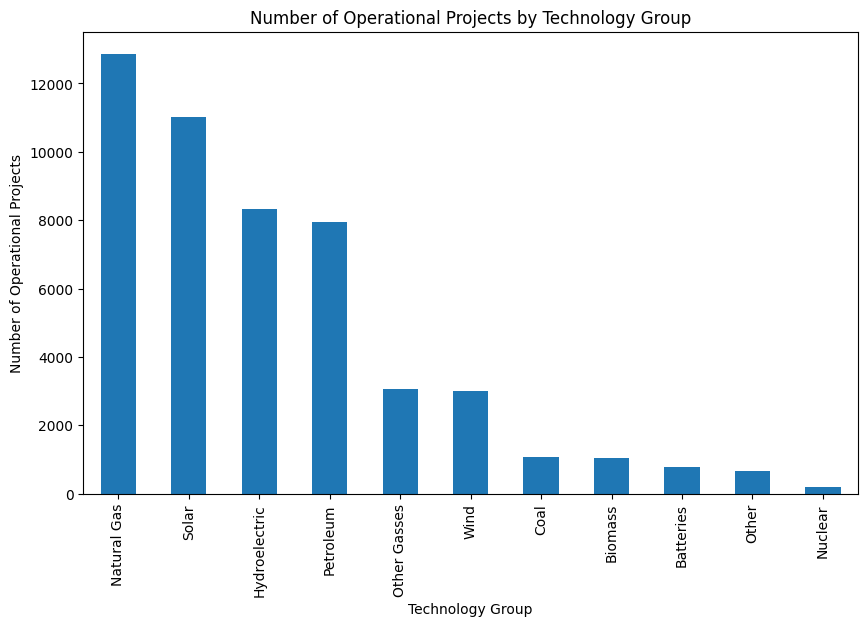

In [40]:
plt.figure(figsize=(10,6))
total_op_group_counts.sort_values(ascending=False).plot(kind='bar')
plt.xlabel('Technology Group')
plt.ylabel('Number of Operational Projects')
plt.title('Number of Operational Projects by Technology Group')
plt.show()

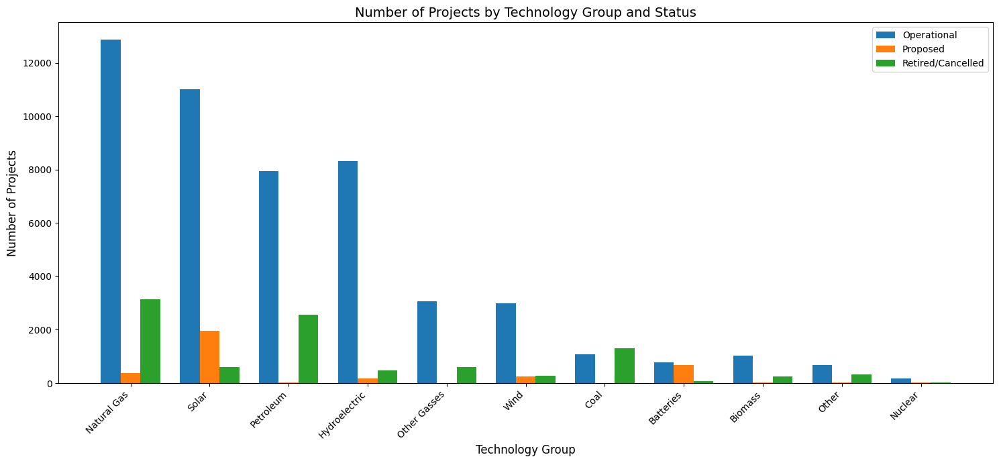

In [41]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming gen22_op_group_counts, gen22_prop_group_counts, and gen22_rc_group_counts are already calculated using the code you provided

# Create a DataFrame from the counts
df_counts = pd.DataFrame({
    'Operational': total_op_group_counts,
    'Proposed': total_prop_group_counts,
    'Retired/Cancelled': total_rc_group_counts
})


df_counts = df_counts.fillna(0)
df_counts['Total'] = df_counts.sum(axis=1)
df_counts = df_counts.sort_values('Total', ascending=False)
df_counts = df_counts.drop(columns='Total')

# Create the bar plot
fig, ax = plt.subplots(figsize=(15, 7))
bar_width = 0.25
index = np.arange(len(df_counts))
ax.bar(index, df_counts['Operational'], bar_width, label='Operational')
ax.bar(index + bar_width, df_counts['Proposed'], bar_width, label='Proposed')
ax.bar(index + 2 * bar_width, df_counts['Retired/Cancelled'], bar_width, label='Retired/Cancelled')
ax.set_xlabel('Technology Group', fontsize=12)
ax.set_ylabel('Number of Projects', fontsize=12)
ax.set_title('Number of Projects by Technology Group and Status', fontsize=14)
ax.set_xticks(index + bar_width)
ax.set_xticklabels(df_counts.index, rotation=45, ha='right')
ax.legend()

plt.tight_layout()
plt.show()

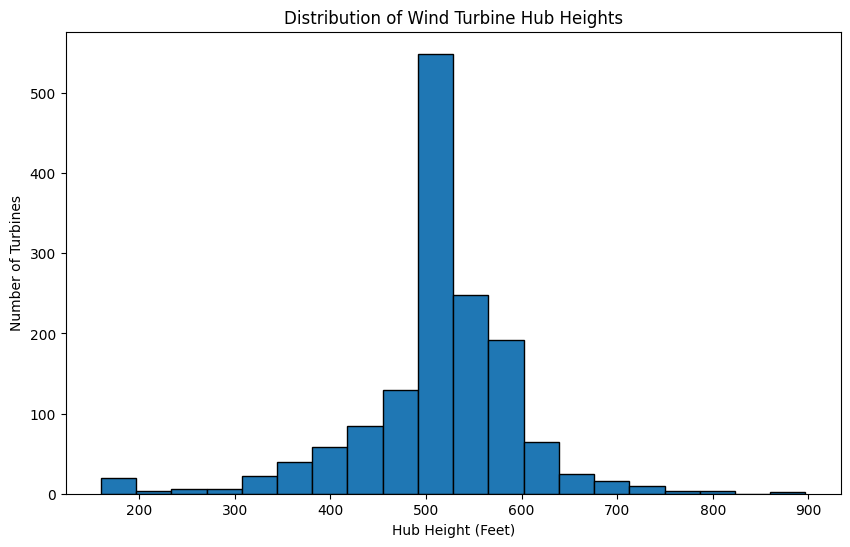

In [42]:
plt.figure(figsize=(10,6))
plt.hist(total_wind_df['Turbine Hub Height (Feet)'], bins=20, edgecolor='black')
plt.title('Distribution of Wind Turbine Hub Heights')
plt.xlabel('Hub Height (Feet)')
plt.ylabel('Number of Turbines')
plt.show()

In [43]:
# Download the FIPS code reference file from the Census Bureau
fips_url = 'https://www2.census.gov/geo/docs/reference/codes/files/national_county.txt'
fips_df = pd.read_csv(fips_url, dtype=str, names=['State', 'StateFP', 'CountyFP', 'CountyName', 'ClassFP'], header=None, sep=',')
fips_df['CountyName'] = fips_df['CountyName'].str.replace(' County', '').str.replace(' Parish', '').str.strip()

In [56]:
total_plant_df['County'] = total_plant_df['County'].str.strip()
total_plant_df['State'] = total_plant_df['State'].str.strip()
total_plant_df = total_plant_df.merge(fips_df, left_on=['County', 'State'], right_on=['CountyName', 'State'], how='left')
total_plant_df['FIPS'] = total_plant_df['StateFP'] + total_plant_df['CountyFP']

In [57]:
county_project_counts = total_plant_df['FIPS'].value_counts().reset_index()
county_project_counts.columns = ['FIPS', 'project_count']

In [58]:
# Load the shapefile
counties = gpd.read_file('cb_2022_us_county_5m\cb_2022_us_county_5m.shx')
#print(counties.head(10))
counties['COUNTY_FIPS'] = counties['STATEFP'] + counties['COUNTYFP']
counties = counties.merge(county_project_counts, left_on='COUNTY_FIPS', right_on='FIPS', how='left')
#counties['project_count'] = counties['project_count'].fillna(0)

In [59]:
import folium

# Create a base map
m = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

# Add the choropleth layer
folium.Choropleth(
    geo_data=counties,
    name='choropleth',
    data=county_project_counts,
    columns=['FIPS', 'project_count'],
    key_on='feature.properties.COUNTY_FIPS',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Operational Energy Projects'
).add_to(m)

m.save('map.html')
m

In [17]:
fig = px.choropleth(counties,
                    geojson=counties.geometry,
                    locations=counties.index,
                    color='project_count',
                    color_continuous_scale='Viridis',
                    scope="usa")

fig.update_geos(fitbounds="locations", visible=False)
fig.show()

In [17]:
import plotly.express as px

# Replace NaNs with 1 in the 'project_count' column
counties['project_count'] = counties['project_count'].fillna(1)

# Define custom color bins
max_count = counties['project_count'].max()
color_bins = [0, 25, 50, 100, 150, 200, max_count]


# Create a custom color scale using the Viridis colormap
viridis_cmap = px.colors.sequential.Viridis
custom_color_scale = []
for i, bin_edge in enumerate(color_bins):
    if i == 0:
        continue
    # Normalize the bin position between 0 and 1
    normalized_bin_pos = bin_edge / max_count
    color = viridis_cmap[int((i-1) / (len(color_bins)-2) * (len(viridis_cmap)-1))]
    custom_color_scale.append([normalized_bin_pos, color])
print(custom_color_scale)
# Create the choropleth map with custom color bins
fig = px.choropleth(
    counties,
    geojson=counties.geometry,
    locations=counties.index,
    color='project_count',
    color_continuous_scale=custom_color_scale,
    #range_color=(1, max_count),  # Assuming you want to start your scale at 1
    scope="usa"
)

fig.update_geos(fitbounds="locations", visible=False)
fig.show()

[[1, '#440154'], [2, '#482878'], [3, '#31688e'], [4, '#1f9e89'], [5, '#6ece58'], [6, '#fde725']]


ValueError: 
    Invalid value of type 'builtins.list' received for the 'colorscale' property of make_figure
        Received value: [[1, '#440154'], [2, '#482878'], [3, '#31688e'], [4, '#1f9e89'], [5, '#6ece58'], [6, '#fde725']]

    The 'colorscale' property is a colorscale and may be
    specified as:
      - A list of colors that will be spaced evenly to create the colorscale.
        Many predefined colorscale lists are included in the sequential, diverging,
        and cyclical modules in the plotly.colors package.
      - A list of 2-element lists where the first element is the
        normalized color level value (starting at 0 and ending at 1),
        and the second item is a valid color string.
        (e.g. [[0, 'green'], [0.5, 'red'], [1.0, 'rgb(0, 0, 255)']])
      - One of the following named colorscales:
            ['aggrnyl', 'agsunset', 'algae', 'amp', 'armyrose', 'balance',
             'blackbody', 'bluered', 'blues', 'blugrn', 'bluyl', 'brbg',
             'brwnyl', 'bugn', 'bupu', 'burg', 'burgyl', 'cividis', 'curl',
             'darkmint', 'deep', 'delta', 'dense', 'earth', 'edge', 'electric',
             'emrld', 'fall', 'geyser', 'gnbu', 'gray', 'greens', 'greys',
             'haline', 'hot', 'hsv', 'ice', 'icefire', 'inferno', 'jet',
             'magenta', 'magma', 'matter', 'mint', 'mrybm', 'mygbm', 'oranges',
             'orrd', 'oryel', 'oxy', 'peach', 'phase', 'picnic', 'pinkyl',
             'piyg', 'plasma', 'plotly3', 'portland', 'prgn', 'pubu', 'pubugn',
             'puor', 'purd', 'purp', 'purples', 'purpor', 'rainbow', 'rdbu',
             'rdgy', 'rdpu', 'rdylbu', 'rdylgn', 'redor', 'reds', 'solar',
             'spectral', 'speed', 'sunset', 'sunsetdark', 'teal', 'tealgrn',
             'tealrose', 'tempo', 'temps', 'thermal', 'tropic', 'turbid',
             'turbo', 'twilight', 'viridis', 'ylgn', 'ylgnbu', 'ylorbr',
             'ylorrd'].
        Appending '_r' to a named colorscale reverses it.
